<a href="https://colab.research.google.com/github/rroszczyk/Python/blob/master/Grafika/Grafika.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [5]:
# przygotowanie katalogu roboczego do pracy :)
import requests

def pobierzPlik(url, nazwaPliku):
    req = requests.get(url, stream=True)
    with open(nazwaPliku, 'wb') as uchwytPliku:
        for chunk in req.iter_content():
            uchwytPliku.write(chunk)

nazwyPlikow = ['lena.png']
for nazwa in nazwyPlikow:
  pobierzPlik("https://github.com/rroszczyk/Python/raw/master/Pliki/"+nazwa, nazwa)

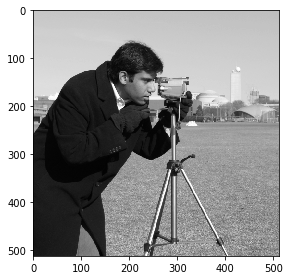

In [1]:
import skimage
from skimage import data
from skimage import io
from matplotlib import pyplot as plt
camera = data.camera ()
io.imshow(camera)
plt.show ()

In [4]:
print(camera)
print(len(camera))

[[200 200 200 ... 189 190 190]
 [200 199 199 ... 190 190 190]
 [199 199 199 ... 190 190 190]
 ...
 [ 25  25  27 ... 139 122 147]
 [ 25  25  26 ... 158 141 168]
 [ 25  25  27 ... 151 152 149]]
512


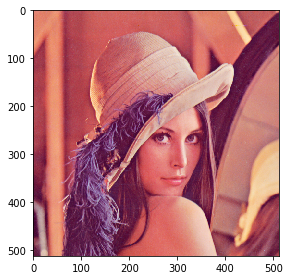

In [6]:
import skimage
from skimage import io
from matplotlib import pyplot as plt
img = io.imread('lena.png')
io.imshow(img)
plt.show ()

In [7]:
import skimage
from skimage import io
from matplotlib import pyplot as plt
img = io.imread('lena.png')
print(img)

[[[226 137 125]
  [226 137 125]
  [223 137 133]
  ...
  [230 148 122]
  [221 130 110]
  [200  99  90]]

 [[226 137 125]
  [226 137 125]
  [223 137 133]
  ...
  [230 148 122]
  [221 130 110]
  [200  99  90]]

 [[226 137 125]
  [226 137 125]
  [223 137 133]
  ...
  [230 148 122]
  [221 130 110]
  [200  99  90]]

 ...

 [[ 84  18  60]
  [ 84  18  60]
  [ 92  27  58]
  ...
  [173  73  84]
  [172  68  76]
  [177  62  79]]

 [[ 82  22  57]
  [ 82  22  57]
  [ 96  32  62]
  ...
  [179  70  79]
  [181  71  81]
  [185  74  81]]

 [[ 82  22  57]
  [ 82  22  57]
  [ 96  32  62]
  ...
  [179  70  79]
  [181  71  81]
  [185  74  81]]]


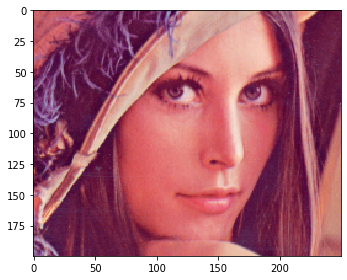

In [8]:
import skimage
from skimage import io
from matplotlib import pyplot as plt25
img = io.imread('lena.png')
rowFrom =200
rowTo =400
columnFrom =150
columnTo =400
slicedImg = img[rowFrom:rowTo , columnFrom:columnTo]

io.imshow(slicedImg)
plt.show()

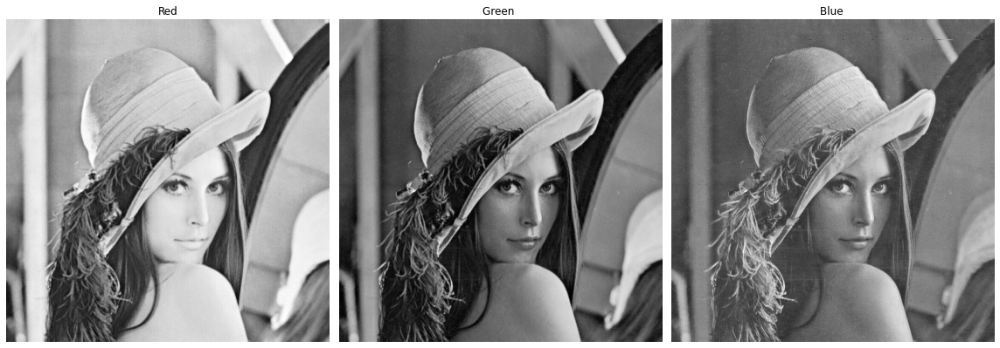

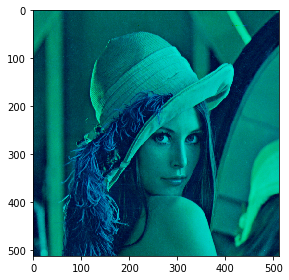

In [11]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
img = io.imread('lena.png')
names =['Red','Green ', 'Blue ']

fig, axes = plt.subplots(nrows=1, ncols=3, figsize =(16, 16))
ax = axes.ravel ()

for i in range (3):
  ax[i].imshow(img[:,:,i], cmap=plt.cm.gray)
  ax[i].set_title(names[i])
  ax[i].axis('off')
plt.tight_layout ()
plt.show ()

img[:,:,0] = 0
io.imshow(img)

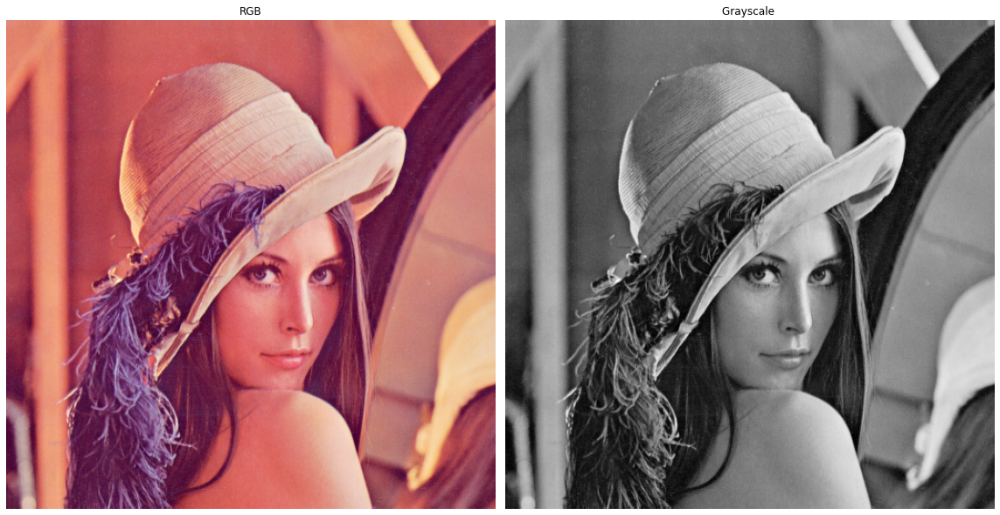

In [13]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
from skimage.color import rgb2gray
img = io.imread('lena.png')
imgG = rgb2gray(img)    # 0.2125 R + 0.7154 G + 0.0721B

imgs =[img ,imgG]
names =['RGB','Grayscale ']

fig, axes = plt.subplots(nrows=1, ncols=2, figsize =(16, 16))

ax = axes.ravel ()

for i in range (2):
  ax[i]. imshow(imgs[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()

In [ ]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
from skimage.color import rgb2gray
from skimage.transform import downscale_local_mean
img = rgb2gray(io.imread('lena.png'))
fig , axes = plt.subplots(nrows=2, ncols=3, figsize =(16, 16))
ax = axes.ravel ()

for i in range (6):
  ax[i]. imshow( downscale_local_mean (img , (2+i*2, 2+i*2)),cmap=plt.cm.gray)
  ax[i]. set_title('Downsample '+ str (2+i*2))
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()

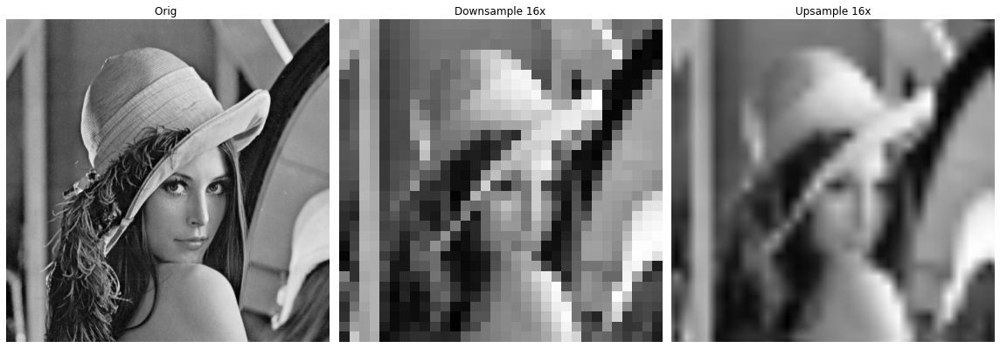

In [16]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
from skimage.color import rgb2gray
from skimage.transform import downscale_local_mean , rescale
img = rgb2gray(io.imread('lena.png'))
imgD = downscale_local_mean (img , (16, 16))
imgU = rescale(imgD ,16, anti_aliasing=False)
imgs =[img ,imgD ,imgU]
names =['Orig ', 'Downsample 16x', 'Upsample 16x']
fig , axes = plt.subplots(nrows=1, ncols=3, figsize =(16, 16))
ax = axes.ravel ()

for i in range (3):
  ax[i]. imshow(imgs[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()

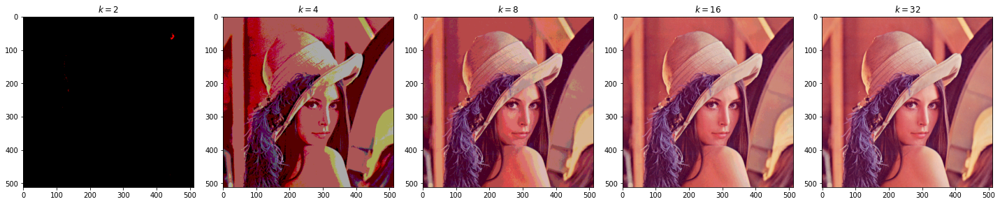

In [17]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
from skimage.color import rgb2gray
import numpy as np
img = (io.imread('lena.png'))
factors = 2**np.arange (1, 6)
figure , axis = plt.subplots (1, len(factors), figsize =(20, 6))
for k, ax in zip(factors , axis):
  bins = np.linspace (0, img.max(), k)
  image = np.digitize(img , bins)
  image = (np.vectorize(bins.tolist ().__getitem__)
  (image -1).astype(int))
  ax.imshow(image)
  ax.set_title('$k = {}$'.format(k))
plt.tight_layout ()
plt.show ()

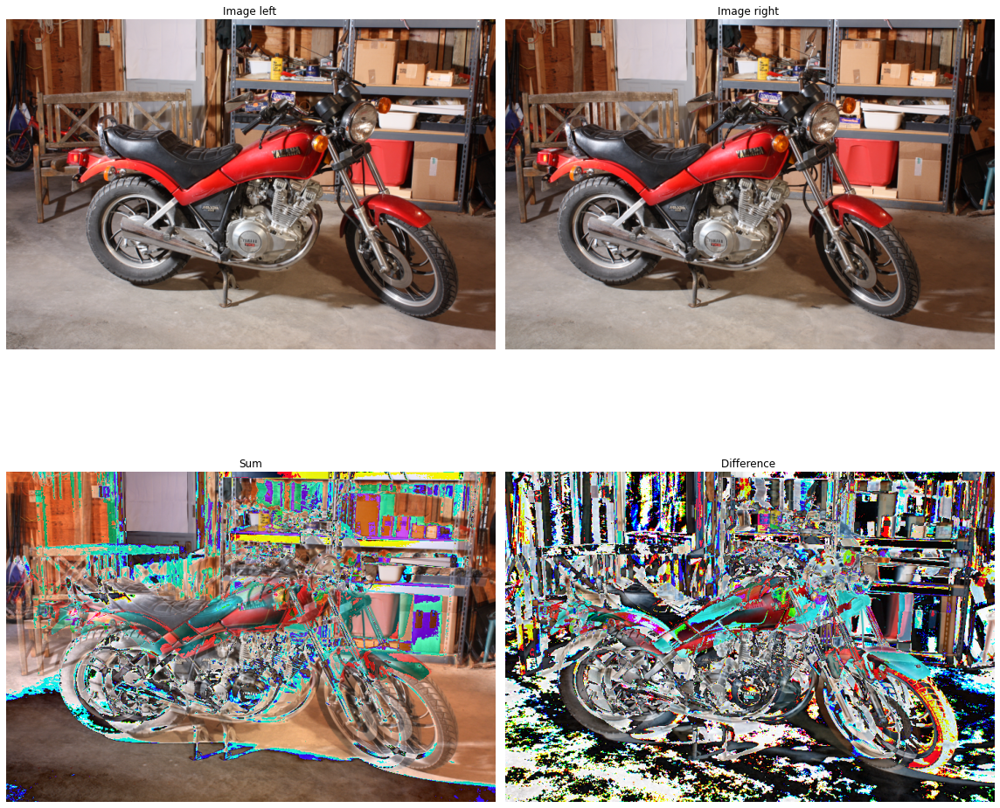

In [18]:
import skimage
from skimage import data
import matplotlib
from matplotlib import pyplot as plt
origImages = data.stereo_motorcycle ()
sumImg = origImages [0] + origImages [1]
diffImg = origImages [0] - origImages [1]
names =['Image left ','Image right ', 'Sum', 'Difference ']
imgs =[ origImages [0], origImages [1],sumImg , diffImg]
fig , axes = plt.subplots(nrows=2, ncols=2, figsize =(16, 16))
ax = axes.ravel ()

for i in range (4):
  ax[i]. imshow(imgs[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in remainder
  import sys


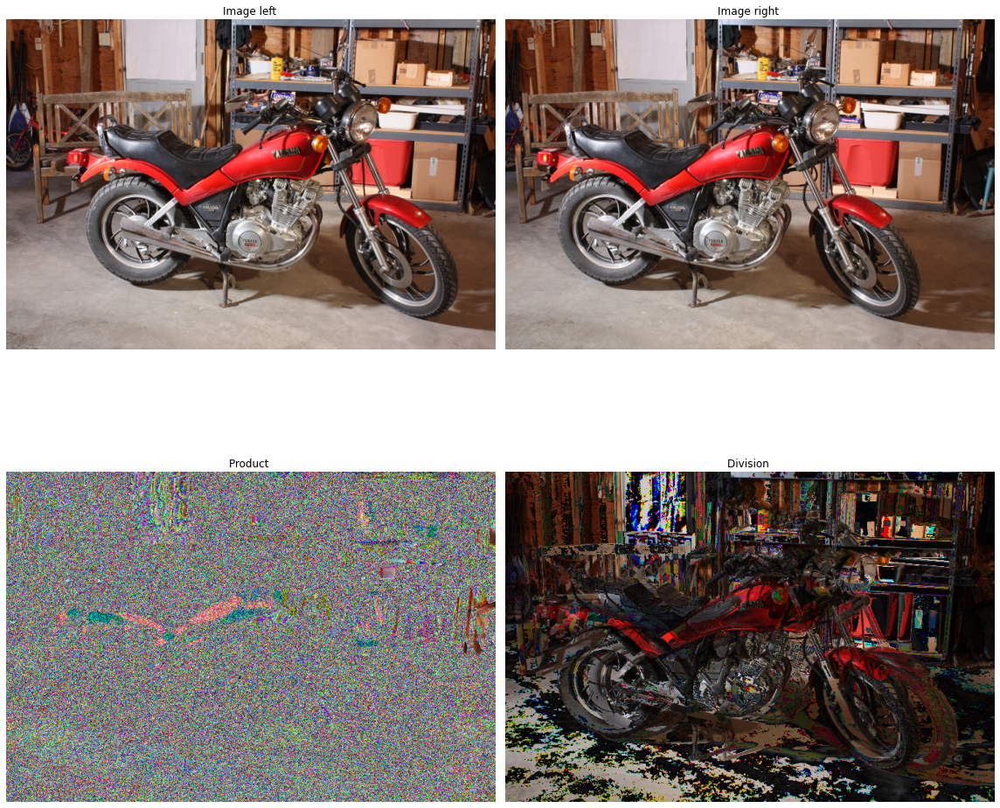

In [19]:
import skimage
from skimage import data
import matplotlib
from matplotlib import pyplot as plt
origImages = data.stereo_motorcycle ()
sumImg = origImages [0] * origImages [1]
diffImg = origImages [0] % origImages [1]
names =['Image left ','Image right ', 'Product ', 'Division ']
imgs =[ origImages [0], origImages [1],sumImg , diffImg]
fig , axes = plt.subplots(nrows=2, ncols=2, figsize =(16, 16))
ax = axes.ravel ()

for i in range (4):
  ax[i]. imshow(imgs[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()

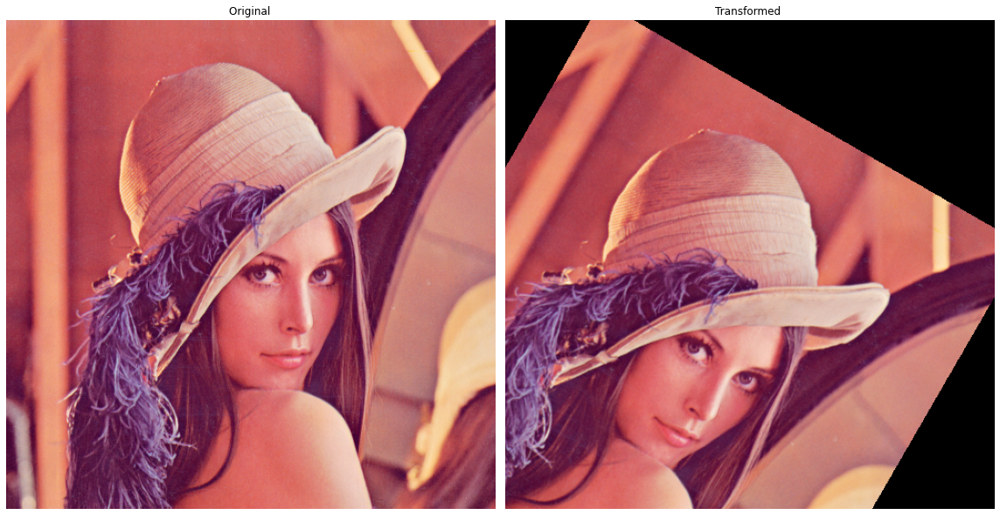

<EuclideanTransform(matrix=
    [[  0.8660254,  -0.5      , 100.       ],
     [  0.5      ,   0.8660254, -20.       ],
     [  0.       ,   0.       ,   1.       ]])>


In [21]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
import numpy as np
from skimage import transform
from skimage import img_as_float
img = img_as_float(io.imread('lena.png'))
transMatrix = transform.EuclideanTransform (
rotation=np.pi / 6.,
translation = (100, -20))
imgT = transform.warp(img ,transMatrix.inverse)
images =[img ,imgT]
names =['Original ', 'Transformed ']
fig , axes = plt.subplots(nrows=1, ncols=2, figsize =(16, 16))
ax = axes.ravel ()

for i in range (2):
  ax[i]. imshow(images[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()
print(transMatrix)

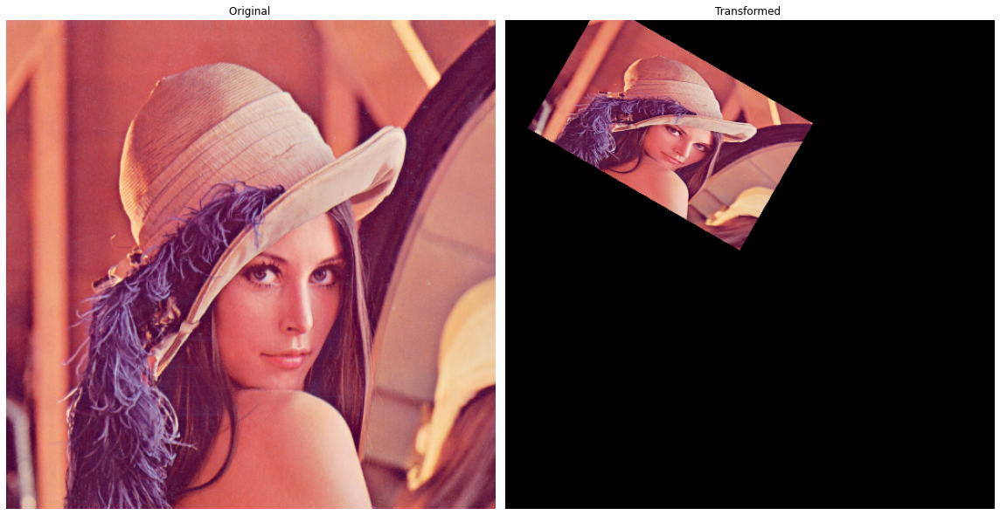

<SimilarityTransform(matrix=
    [[  0.4330127 ,  -0.15      , 100.        ],
     [  0.25      ,   0.25980762, -20.        ],
     [  0.        ,   0.        ,   1.        ]])>


In [23]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
import numpy as np
from skimage import transform
from skimage import img_as_float
img = img_as_float(io.imread('lena.png'))
transMatrix = transform. SimilarityTransform (scale =(0.5 ,0.3) ,
rotation=np.pi / 6.,
translation = (100, -20))
imgT = transform.warp(img ,transMatrix.inverse)
images =[img ,imgT]
names =['Original ', 'Transformed ']
fig , axes = plt.subplots(nrows=1, ncols=2, figsize =(16, 16))
ax = axes.ravel ()

for i in range (2):
  ax[i]. imshow(images[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()
print(transMatrix)

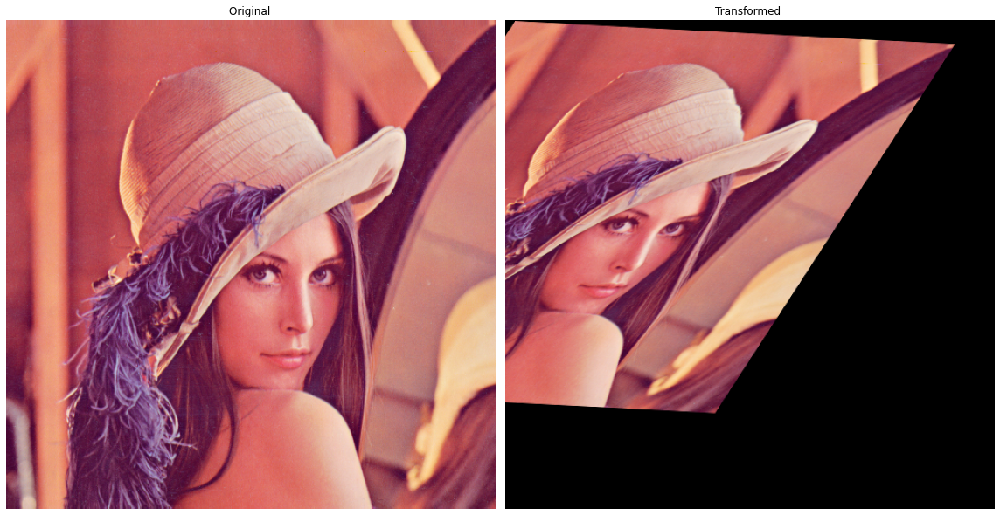

<AffineTransform(matrix=
    [[ 0.89876658, -0.49017513, 10.        ],
     [ 0.04710236,  0.75480351,  1.        ],
     [ 0.        ,  0.        ,  1.        ]])>


In [24]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
import numpy as np
from skimage import transform
from skimage import img_as_float
img = img_as_float(io.imread('lena.png'))
transMatrix = transform.AffineTransform (scale =0.9, shear=np.pi/6,
rotation=np.pi / 60.,
translation = (10, 1))
imgT = transform.warp(img ,transMatrix.inverse)
images =[img ,imgT]
names =['Original ', 'Transformed ']
fig , axes = plt.subplots(nrows=1, ncols=2, figsize =(16, 16))
ax = axes.ravel ()

for i in range (2):
  ax[i]. imshow(images[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()
print(transMatrix)

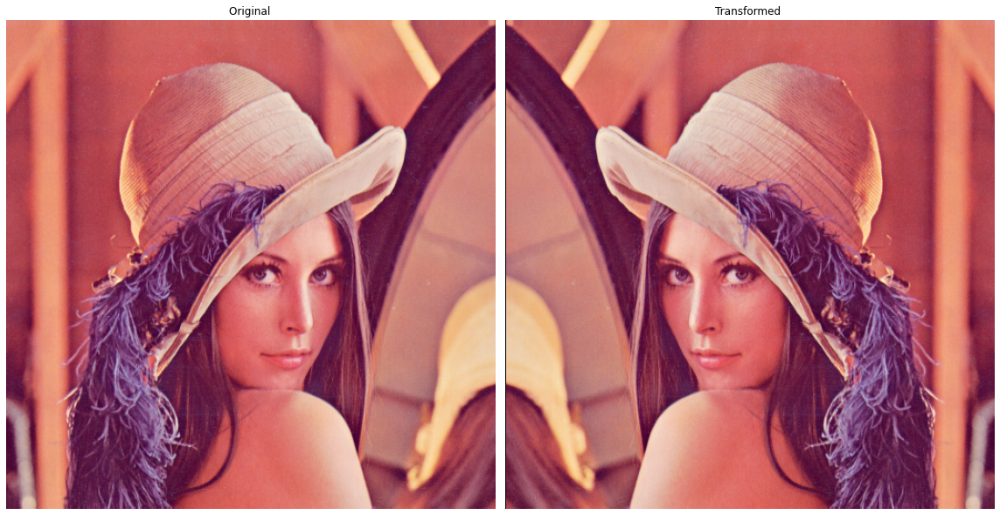

<EuclideanTransform(matrix=
    [[ -1,   0, 512],
     [  0,   1,   0],
     [  0,   0,   1]])>


In [25]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
import numpy as np
from skimage import transform
from skimage import img_as_float
img = img_as_float(io.imread('lena.png'))
transMatrix = transform.EuclideanTransform ( np.array ([[ -1 ,0 ,img.shape [1] ],[ 0 ,1, 0 ] ,[0 ,0 ,1]]))
imgT = transform.warp(img ,transMatrix.inverse)
images =[img ,imgT]
names =['Original ', 'Transformed ']
fig , axes = plt.subplots(nrows=1, ncols=2, figsize =(16, 16))
ax = axes.ravel ()

for i in range (2):
  ax[i]. imshow(images[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()
print(transMatrix)

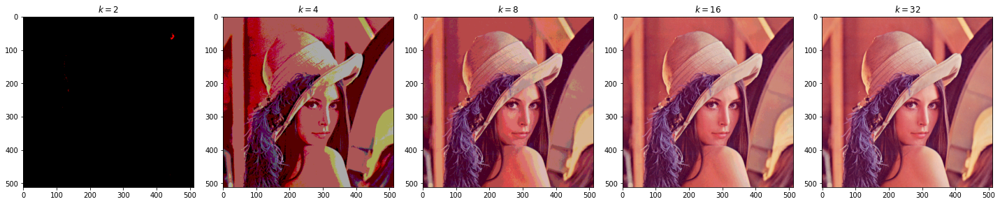

In [26]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
from skimage.color import rgb2gray
import numpy as np
img = (io.imread('lena.png'))
factors = 2**np.arange (1, 6)
figure , axis = plt.subplots (1, len(factors), figsize =(20, 6))
for k, ax in zip(factors , axis):
  bins = np.linspace (0, img.max(), k)
  image = np.digitize(img , bins)
  image = (np.vectorize(bins.tolist ().__getitem__) (image -1).astype(int))
  ax.imshow(image)
  ax.set_title('$k = {}$'.format(k))
plt.tight_layout ()
plt.show ()

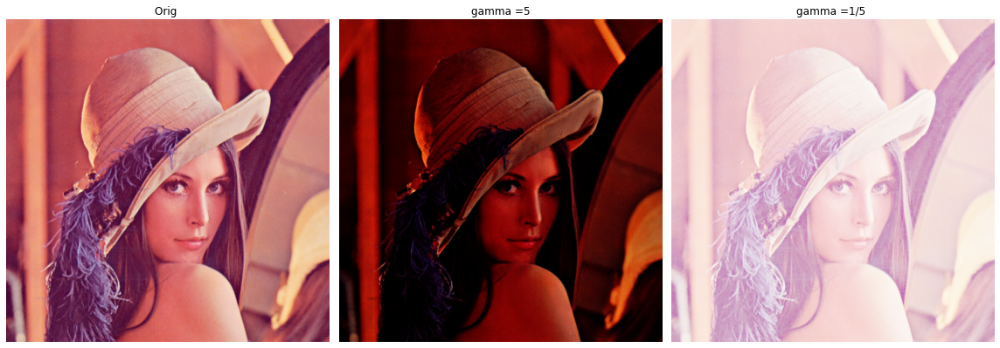

In [27]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
from skimage import exposure
img = io.imread('lena.png')
imgG1 = exposure.adjust_gamma(img , 5)
imgG2 = exposure.adjust_gamma(img , 1/5)
imgs =[img ,imgG1 ,imgG2]
names =['Orig ', 'gamma =5', 'gamma =1/5 ']
fig , axes = plt.subplots(nrows=1, ncols=3, figsize =(16, 16))
ax = axes.ravel ()

for i in range (3):
  ax[i]. imshow(imgs[i])
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()

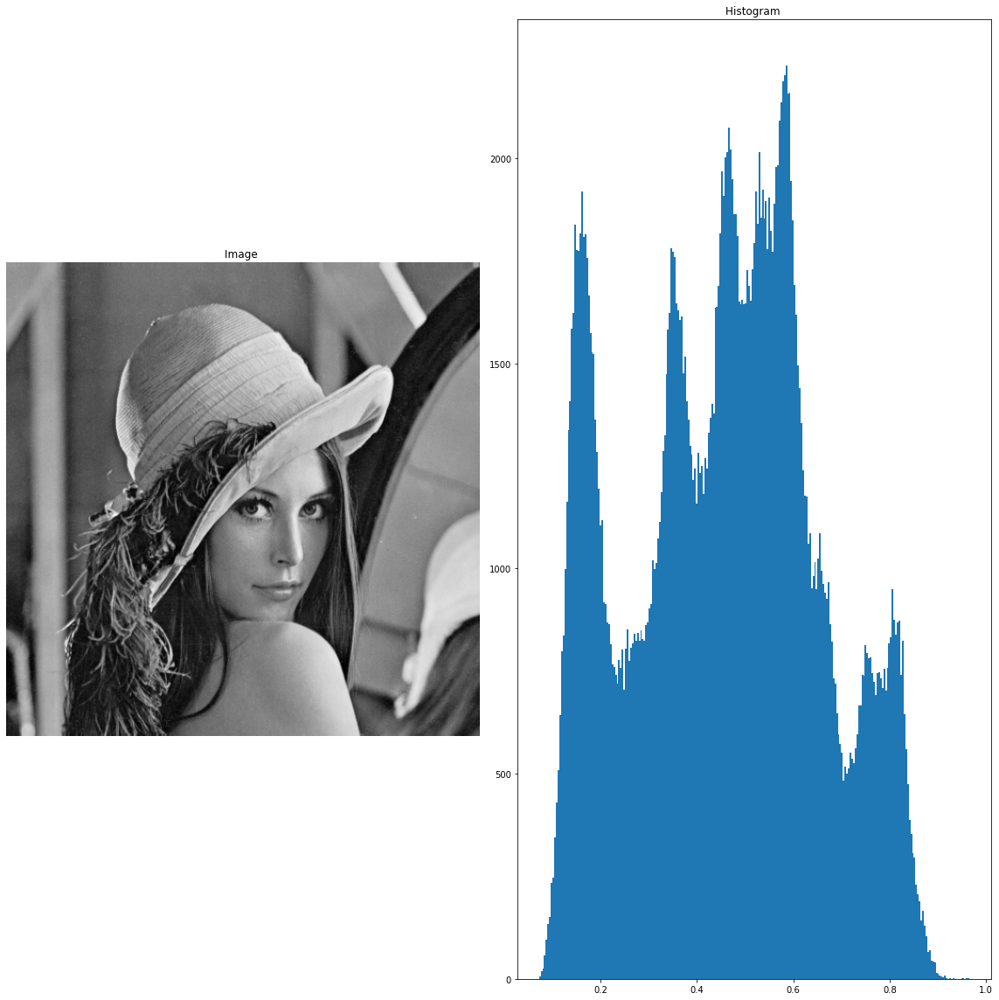

In [28]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
from skimage import exposure
from skimage.color import rgb2gray
img = rgb2gray(io.imread('lena.png'))
fig , axes = plt.subplots(nrows=1, ncols=2, figsize =(16, 16))
ax = axes.ravel ()
ax [0]. imshow(img ,cmap=plt.cm.gray)
ax [0]. set_title('Image ')
ax [0]. axis('off')
ax [1]. hist(img.ravel (), bins =255)
ax [1]. set_title('Histogram ')
plt.tight_layout ()
plt.show ()

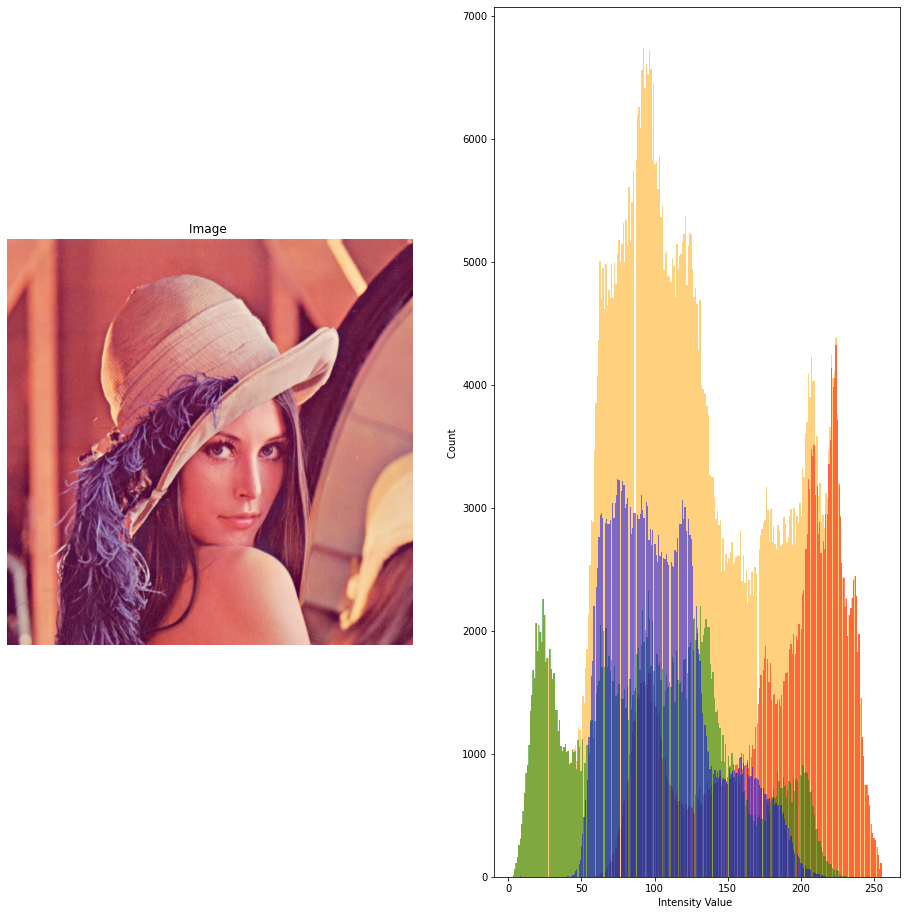

In [29]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
from skimage import exposure
from skimage.color import rgb2gray
img = (io.imread('lena.png'))
fig , axes = plt.subplots(nrows=1, ncols=2, figsize =(16, 16))
ax = axes.ravel ()
ax [0]. imshow(img ,cmap=plt.cm.gray)
ax [0]. set_title('Image ')
ax [0]. axis('off')
ax [1]. hist(img.ravel (), bins =255, color='orange',alpha =0.5)
colors =['red','green','blue']
for i in range (3):
  ax [1]. hist(img[:,:,i]. ravel (), bins =255, color=colors[i],alpha =0.5)
ax[1] = plt.xlabel('Intensity Value ')
ax[1] = plt.ylabel('Count ')

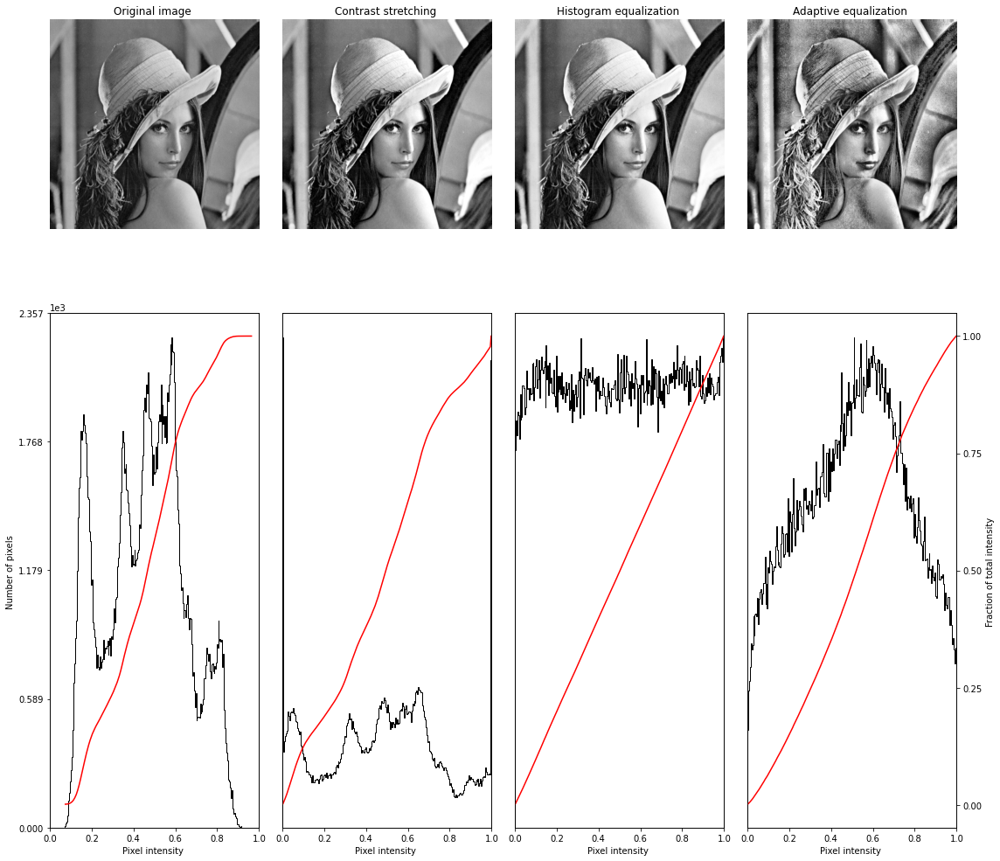

In [30]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from skimage import data , img_as_float
from skimage import exposure
from skimage.color import rgb2gray
from skimage import io

def plot_img_and_hist (image , axes , bins =256):
  """ Plot an image along with its histogram and cumulative histogram."""
  image = img_as_float(image)
  ax_img , ax_hist = axes
  ax_cdf = ax_hist.twinx ()
  ax_img.imshow(image , cmap=plt.cm.gray)
  ax_img.set_axis_off ()
  ax_hist.hist(image.ravel (), bins=bins , histtype='step', color='black')
  ax_hist.ticklabel_format (axis='y', style='scientific', scilimits =(0, 0))
  ax_hist.set_xlabel('Pixel intensity ')
  ax_hist.set_xlim (0, 1)
  ax_hist.set_yticks ([])
  img_cdf , bins = exposure. cumulative_distribution (image , bins)
  ax_cdf.plot(bins , img_cdf , 'r')
  ax_cdf.set_yticks ([])
  return ax_img , ax_hist , ax_cdf

# Load an example image
img = rgb2gray(io.imread('lena.png'))
# Contrast stretching
p2 , p98 = np.percentile(img , (2, 98))
img_rescale = exposure.rescale_intensity (img , in_range =(p2 , p98))
# Equalization
img_eq = exposure.equalize_hist(img)
# Adaptive Equalization
img_adapteq = exposure.equalize_adapthist (img , clip_limit =0.03)  

fig = plt.figure(figsize =(16, 16))
axes = np.zeros ((2, 4), dtype=object)
axes[0, 0] = fig.add_subplot (2, 4, 1)
for i in range(1, 4):
  axes[0, i] = fig.add_subplot (2, 4, 1+i, sharex=axes [0,0], sharey=axes [0 ,0])
for i in range(0, 4):
  axes[1, i] = fig.add_subplot (2, 4, 5+i)

ax_img , ax_hist , ax_cdf = plot_img_and_hist (img , axes[:, 0])
ax_img.set_title('Original image ')
y_min , y_max = ax_hist.get_ylim ()
ax_hist.set_ylabel('Number of pixels ')
ax_hist.set_yticks(np.linspace (0, y_max , 5))
ax_img , ax_hist , ax_cdf = plot_img_and_hist (img_rescale , axes[:, 1])
ax_img.set_title('Contrast stretching ')
ax_img , ax_hist , ax_cdf = plot_img_and_hist (img_eq , axes[:, 2])
ax_img.set_title('Histogram equalization ')
ax_img , ax_hist , ax_cdf = plot_img_and_hist (img_adapteq , axes[:, 3])
ax_img.set_title('Adaptive equalization ')
ax_cdf.set_ylabel('Fraction of total intensity ')
ax_cdf.set_yticks(np.linspace (0, 1, 5))
fig.tight_layout ()
plt.show ()  

0.43353890701593134


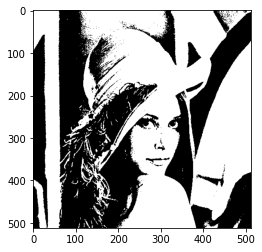

In [31]:
import matplotlib
import matplotlib.pyplot as plt
from skimage.filters import threshold_otsu
from skimage.color import rgb2gray
from skimage import io
image = rgb2gray(io.imread('lena.png'))
thresh = threshold_otsu(image)
print(thresh)

binary_mask = image > thresh

plt.imshow(binary_mask, cmap="gray")
plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: RuntimeWarning: Images with dimensions (M, N, 3) are interpreted as 2D+RGB by default. Use `multichannel=False` to interpret as 3D image with last dimension of length 3.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: Images with dimensions (M, N, 3) are interpreted as 2D+RGB by default. Use `multichannel=False` to interpret as 3D image with last dimension of length 3.
  if __name__ == '__main__':


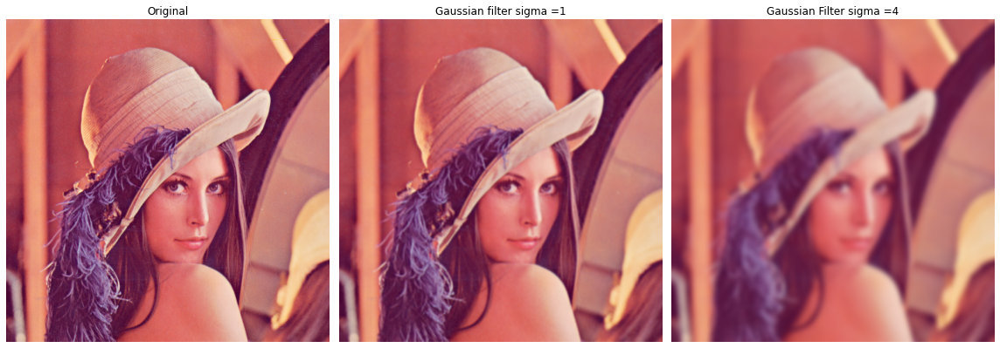

In [32]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
import numpy as np
from skimage.filters import gaussian
img = (io.imread('lena.png'))
filtered = gaussian(img ,sigma =1)
filtered2 = gaussian(img ,sigma =4)
images =[img ,filtered ,filtered2]
names =['Original', 'Gaussian filter sigma =1', 'Gaussian Filter sigma =4']
fig , axes = plt.subplots(nrows=1, ncols=3, figsize =(16, 16))
ax = axes.ravel ()
for i in range (3):
  ax[i]. imshow(images[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()

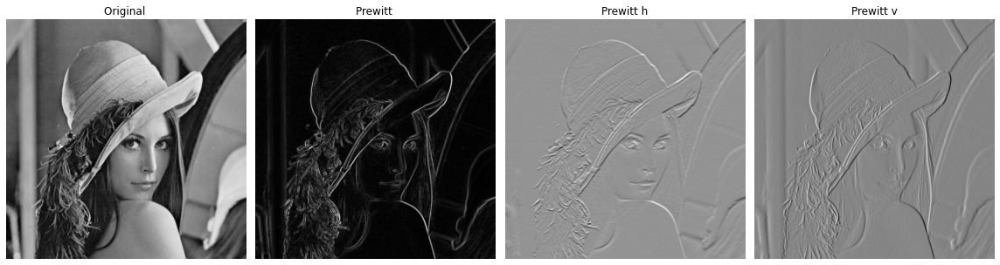

In [33]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
import numpy as np
from skimage import filters
from skimage.color import rgb2gray
img = rgb2gray(io.imread('lena.png'))
filtered = filters.prewitt(img)
filtered2 = filters.prewitt_h(img)
filtered3 = filters.prewitt_v(img)
images =[img ,filtered ,filtered2 , filtered3]
names =['Original ', 'Prewitt ', 'Prewitt h', 'Prewitt v']
fig , axes = plt.subplots(nrows=1, ncols=4, figsize =(16, 16))
ax = axes.ravel ()

for i in range (4):
  ax[i]. imshow(images[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()

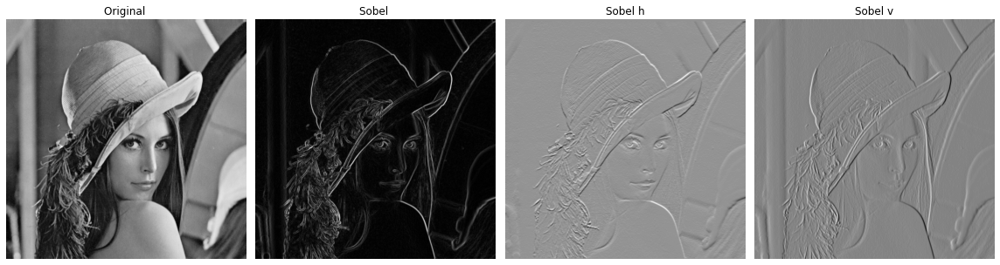

In [34]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
import numpy as np
from skimage import filters
from skimage.color import rgb2gray
img = rgb2gray(io.imread('lena.png'))
filtered = filters.sobel(img)
filtered2 = filters.sobel_h(img)
filtered3 = filters.sobel_v(img)
images =[img ,filtered ,filtered2 , filtered3]
names =['Original ', 'Sobel ', 'Sobel h', 'Sobel v']
fig , axes = plt.subplots(nrows=1, ncols=4, figsize =(16, 16))
ax = axes.ravel ()
for i in range (4):
  ax[i]. imshow(images[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()

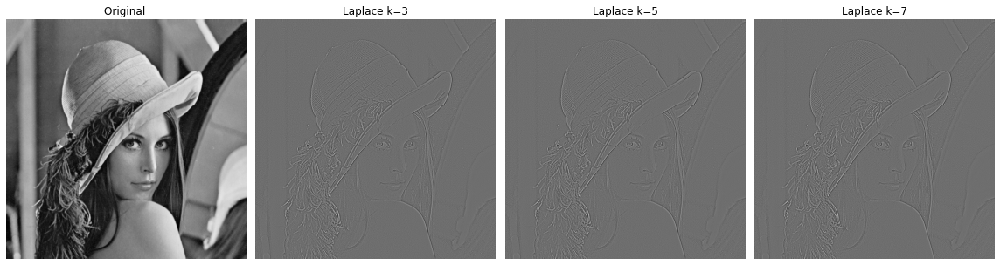

In [35]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
import numpy as np
from skimage import filters
from skimage.color import rgb2gray
img = rgb2gray(io.imread('lena.png'))
filtered = filters.laplace(img ,ksize =3)
filtered2 = filters.laplace(img ,ksize =5)
filtered3 = filters.laplace(img ,ksize =7)
images =[img ,filtered ,filtered2 , filtered3]
names =['Original ', 'Laplace k=3', 'Laplace k=5', 'Laplace k=7']
fig , axes = plt.subplots(nrows=1, ncols=4, figsize =(16, 16))
ax = axes.ravel ()
for i in range (4):
  ax[i]. imshow(images[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()

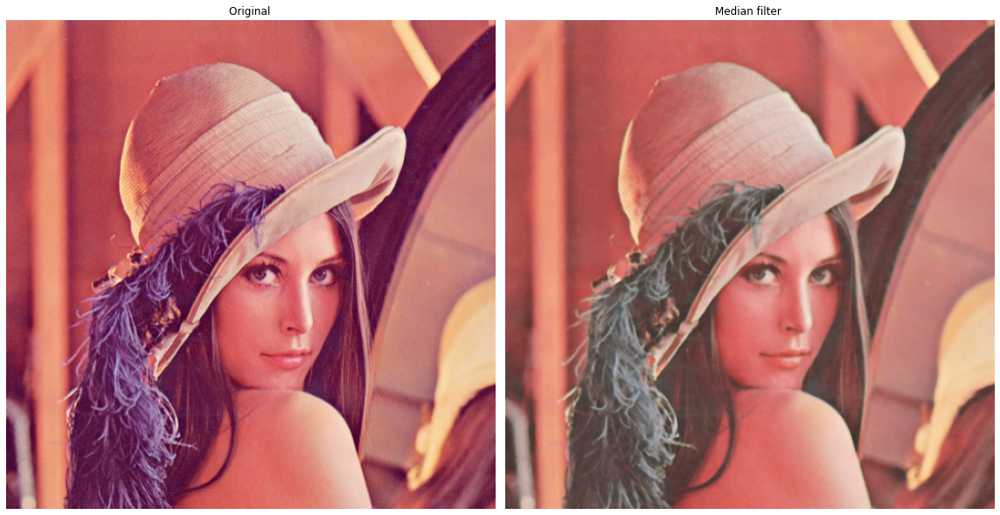

In [36]:
import skimage
from skimage import io
import matplotlib
from matplotlib import pyplot as plt
import numpy as np
from skimage.filters import median
img = (io.imread('lena.png'))
filtered = median(img)
images =[img ,filtered]
names =['Original ', 'Median filter ']
fig , axes = plt.subplots(nrows=1, ncols=2, figsize =(16, 16))
ax = axes.ravel()

for i in range (2):
  ax[i]. imshow(images[i],cmap=plt.cm.gray)
  ax[i]. set_title(names[i])
  ax[i]. axis('off')
plt.tight_layout ()
plt.show ()

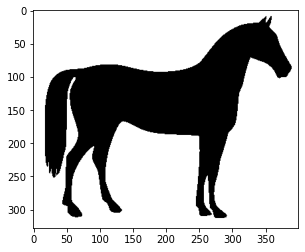

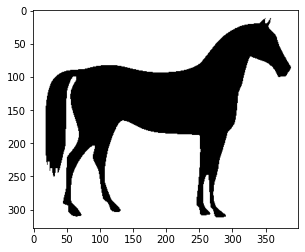

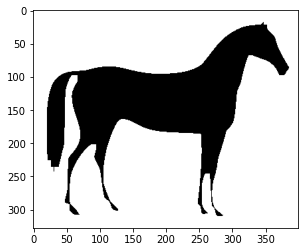

In [37]:
import skimage
import matplotlib
from matplotlib import pyplot as plt
from skimage import data
from skimage import morphology
from skimage import util
img = util.invert(data.horse ())
mask = morphology.rectangle (3,3)
mask2 = morphology.rectangle (7,7)
transformed = morphology.erosion(img ,mask)
transformed2 = morphology.erosion(img ,mask2)

plt.imshow(img, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed2, cmap=plt.cm.binary)
plt.show()

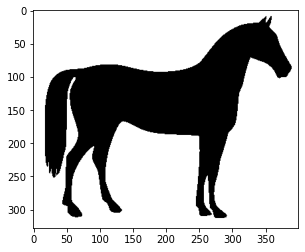

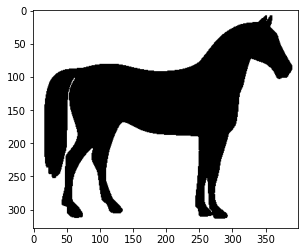

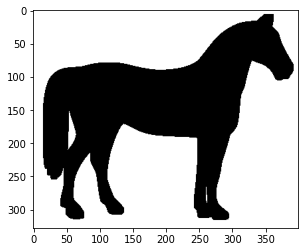

In [38]:
import skimage
import matplotlib
from matplotlib import pyplot as plt
from skimage import data
from skimage import morphology
from skimage import util
img = util.invert(data.horse ())
mask = morphology.rectangle (3,3)
mask2 = morphology.rectangle (7,7)
transformed = morphology.dilation(img ,mask)
transformed2 = morphology.dilation(img ,mask2)
plt.imshow(img, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed2, cmap=plt.cm.binary)
plt.show()

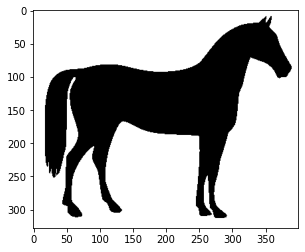

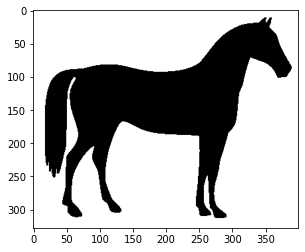

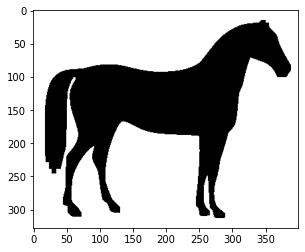

In [39]:
import skimage
import matplotlib
from matplotlib import pyplot as plt
from skimage import data
from skimage import morphology
from skimage import util
img = util.invert(data.horse ())
mask = morphology.rectangle (3,3)
mask2 = morphology.rectangle (7,7)
transformed = morphology.opening(img ,mask)
transformed2 = morphology.opening(img ,mask2)
plt.imshow(img, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed2, cmap=plt.cm.binary)
plt.show()

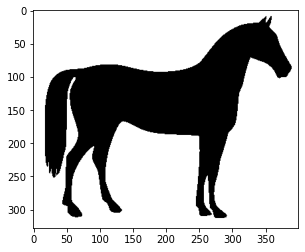

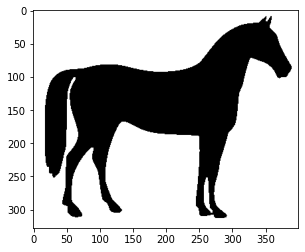

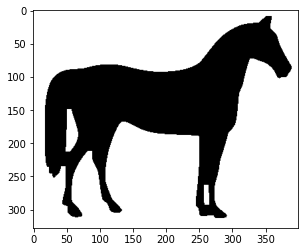

In [40]:
import skimage
import matplotlib
from matplotlib import pyplot as plt
from skimage import data
from skimage import morphology
from skimage import util
img = util.invert(data.horse ())
mask = morphology.rectangle (3,3)
mask2 = morphology.rectangle (7,7)
transformed = morphology.closing(img ,mask)
transformed2 = morphology.closing(img ,mask2)
plt.imshow(img, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed2, cmap=plt.cm.binary)
plt.show()

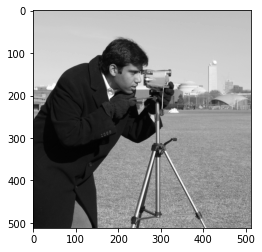

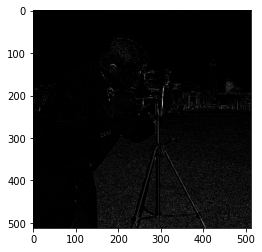

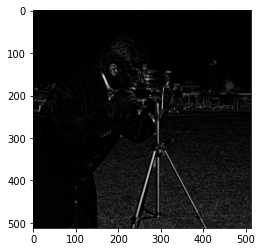

In [41]:
import skimage
import matplotlib
from matplotlib import pyplot as plt
from skimage import data
from skimage import morphology
from skimage import util
img = data.camera ()
mask = morphology.rectangle (3,3)
mask2 = morphology.rectangle (7,7)
transformed = morphology.white_tophat(img ,mask)
transformed2 = morphology.white_tophat(img ,mask2)
plt.imshow(img, cmap=plt.cm.gray)
plt.show()
plt.imshow(transformed, cmap=plt.cm.gray)
plt.show()
plt.imshow(transformed2, cmap=plt.cm.gray)
plt.show()

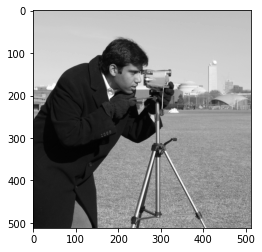

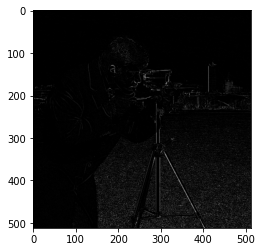

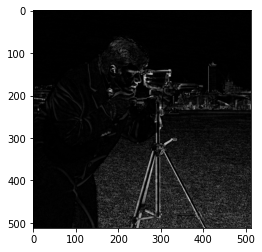

In [42]:
import skimage
import matplotlib
from matplotlib import pyplot as plt
from skimage import data
from skimage import morphology
from skimage import util
img = data.camera ()
mask = morphology.rectangle (3,3)
mask2 = morphology.rectangle (7,7)
transformed = morphology.black_tophat(img ,mask)
transformed2 = morphology.black_tophat(img ,mask2)
plt.imshow(img, cmap=plt.cm.gray)
plt.show()
plt.imshow(transformed, cmap=plt.cm.gray)
plt.show()
plt.imshow(transformed2, cmap=plt.cm.gray)
plt.show()

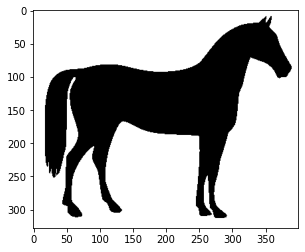

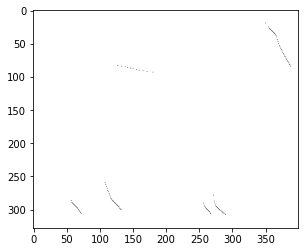

In [43]:
import skimage
import matplotlib
from matplotlib import pyplot as plt
from skimage import data
from skimage import util
from scipy.ndimage import morphology

img = util.invert(data.horse ())
mask = [[1 ,1 ,0] ,[1 ,1 ,1] ,[1 ,1 ,1]]
transformed = morphology.binary_hit_or_miss (img , mask)
plt.imshow(img, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed, cmap=plt.cm.binary)
plt.show()

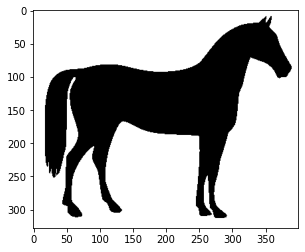

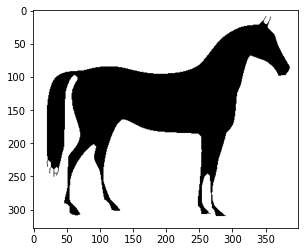

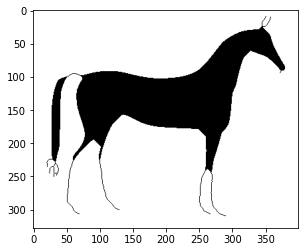

In [44]:
import skimage
import matplotlib
from matplotlib import pyplot as plt
from skimage import data
from skimage import morphology
from skimage import util
img = util.invert(data.horse ())
transformed = morphology.thin(img ,3)
transformed2 = morphology.thin(img ,10)
plt.imshow(img, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed2, cmap=plt.cm.binary)
plt.show()

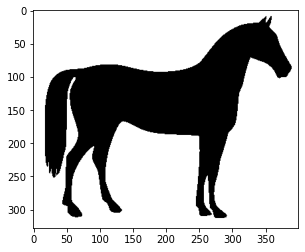

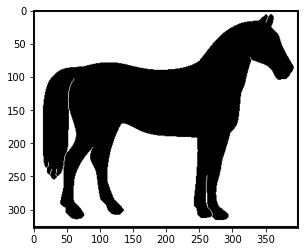

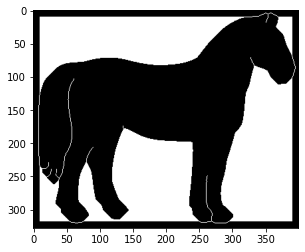

In [45]:
import skimage
import matplotlib
from matplotlib import pyplot as plt
from skimage import data
from skimage import morphology
from skimage import util
img = util.invert(data.horse ())
nimg = util.invert(img)
transformed = util.invert(morphology.thin(nimg ,3))
transformed2 = util.invert(morphology.thin(nimg,10))
plt.imshow(img, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed2, cmap=plt.cm.binary)
plt.show()

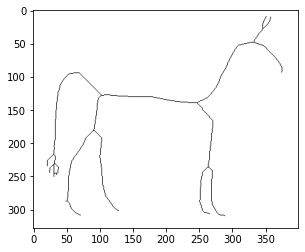

In [46]:
import skimage
import matplotlib
from matplotlib import pyplot as plt
from skimage import data
from skimage import morphology
from skimage import util

img = util.invert(data.horse ())
mask = morphology.rectangle (3,3)
transformed = morphology.skeletonize(img)
plt.show()
plt.imshow(transformed, cmap=plt.cm.binary)
plt.show()

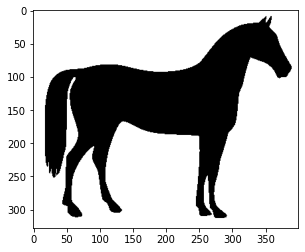

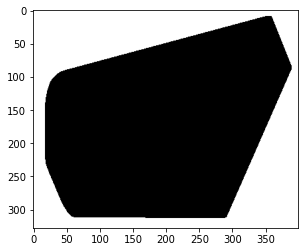

In [47]:
import skimage
import matplotlib
from matplotlib import pyplot as plt
from skimage import data
from skimage import morphology
from skimage import util

img = util.invert(data.horse ())
transformed = morphology.convex_hull_image (img)
plt.imshow(img, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed, cmap=plt.cm.binary)
plt.show()


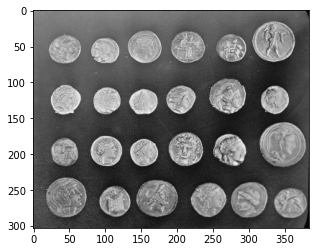

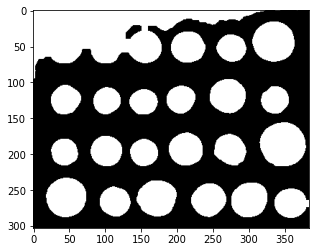

In [48]:
img = data.coins ()
mask = morphology.rectangle (7,7)
imgp1 = skimage.filters.median(img, mask)
thresh = threshold_otsu(imgp1)
binary = imgp1 > thresh
transformed = morphology.closing(binary, mask)
transformed2 = morphology.opening(transformed, mask)
plt.imshow(img, cmap=plt.cm.gray)
plt.show()
plt.imshow(transformed, cmap=plt.cm.gray)
plt.show()

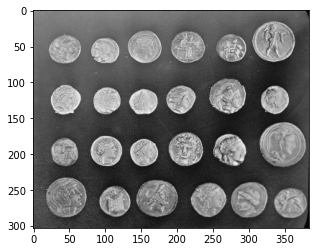

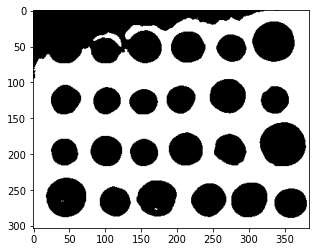

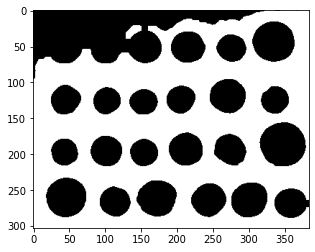

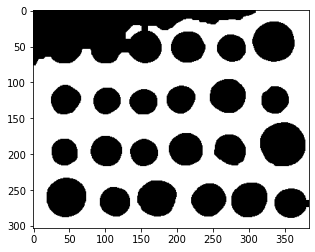

In [49]:
img = data.coins ()
mask = morphology.rectangle (7,7)
imgp1 = skimage.filters.median(img ,mask)
thresh = threshold_otsu(imgp1)
binary = imgp1 > thresh
transformed = morphology.closing(binary ,mask)
transformed2 = morphology.opening(transformed,mask)
plt.imshow(img, cmap=plt.cm.gray)
plt.show()
plt.imshow(binary, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed, cmap=plt.cm.binary)
plt.show()
plt.imshow(transformed2, cmap=plt.cm.binary)
plt.show()